In [1]:
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from mpl_toolkits.axes_grid1 import make_axes_locatable
import seaborn as sns

from pandas import set_option
# set_option("display.max_rows", 10)
pd.options.mode.chained_assignment = None

filename = 'data/facies_vectors.csv'
training_data = pd.read_csv(filename)
training_data.head()

,Facies,Formation,Well Name,Depth,GR,ILD_log10,DeltaPHI,PHIND,PE,NM_M,RELPOS
0,3,A1 SH,SHRIMPLIN,2793.0,77.45,0.664,9.9,11.915,4.6,1,1.000
1,3,A1 SH,SHRIMPLIN,2793.5,78.26,0.661,14.2,12.565,4.1,1,0.979
2,3,A1 SH,SHRIMPLIN,2794.0,79.05,0.658,14.8,13.050,3.6,1,0.957
3,3,A1 SH,SHRIMPLIN,2794.5,86.10,0.655,13.9,13.115,3.5,1,0.936
4,3,A1 SH,SHRIMPLIN,2795.0,74.58,0.647,13.5,13.300,3.4,1,0.915


In [2]:
def make_moving_max_vars(wells_df,logs,windows):
    new_df = pd.DataFrame()
    grouped = wells_df.groupby(['Well Name'])

    for key in grouped.groups.keys():
        temp_df = pd.DataFrame()
        temp_df['Depth'] = grouped.get_group(key)['Depth']
        
        for log in logs:

            temp_data = grouped.get_group(key)[log]
            
            for window in windows:
                temp_df[log + '_moving_max_' + str(window) + 'ft'] = pd.rolling_max(arg=temp_data, window=window, min_periods=1, center=True)                
                
        temp_df['Well Name'] = [key for _ in range(len(temp_df['Depth']))]
        new_df = new_df.append(temp_df) 

        
    new_df = new_df.sort_index()
    new_df = new_df.drop(['Well Name','Depth'],axis=1)
    wells_df = wells_df[['Facies', 'Formation', 'Well Name', 'Depth']]
    return pd.concat([wells_df,new_df],axis=1)

In [3]:
##### From moving standard deviation
moving_max_df = make_moving_max_vars(wells_df=training_data, logs=['GR', 'ILD_log10', 'DeltaPHI', 'PE', 'PHIND'], windows=[3, 4, 5, 7, 10, 15, 20])
print (moving_max_df.shape)
moving_max_df.head(5)

(4149, 39)


,Facies,Formation,Well Name,Depth,GR_moving_max_3ft,GR_moving_max_4ft,GR_moving_max_5ft,GR_moving_max_7ft,GR_moving_max_10ft,GR_moving_max_15ft,...,PE_moving_max_10ft,PE_moving_max_15ft,PE_moving_max_20ft,PHIND_moving_max_3ft,PHIND_moving_max_4ft,PHIND_moving_max_5ft,PHIND_moving_max_7ft,PHIND_moving_max_10ft,PHIND_moving_max_15ft,PHIND_moving_max_20ft
0,3,A1 SH,SHRIMPLIN,2793.0,78.26,78.26,79.05,86.1,86.1,86.1,...,4.6,4.6,4.6,12.565,12.565,13.050,13.115,13.300,13.93,14.22
1,3,A1 SH,SHRIMPLIN,2793.5,79.05,79.05,86.10,86.1,86.1,86.1,...,4.6,4.6,4.6,13.050,13.050,13.115,13.300,13.385,13.98,14.22
2,3,A1 SH,SHRIMPLIN,2794.0,86.10,86.10,86.10,86.1,86.1,86.1,...,4.6,4.6,4.6,13.115,13.115,13.300,13.385,13.930,14.22,14.22
3,3,A1 SH,SHRIMPLIN,2794.5,86.10,86.10,86.10,86.1,86.1,86.1,...,4.6,4.6,4.6,13.300,13.300,13.385,13.930,13.930,14.22,14.22
4,3,A1 SH,SHRIMPLIN,2795.0,86.10,86.10,86.10,86.1,86.1,86.1,...,4.6,4.6,4.6,13.385,13.385,13.930,13.930,13.980,14.22,14.93


In [4]:
####### Creating dictionary of colours for the different facies
facies_colors = {1:'#F4D03F', 2:'#F5B041',3:'#DC7633',4:'#6E2C00',
       5:'#1B4F72',6:'#2E86C1', 7:'#AED6F1', 8:'#A569BD', 9:'#196F3D'}
facies_name = {1:'SS', 2:'CSiS',3:'FSiS',4:'SiSh', 5:'MS',6:'WS', 7:'D', 8:'PS', 9:'BS'}

flatui = ['#F4D03F', '#F5B041', '#DC7633', '#6E2C00',
       '#1B4F72', '#2E86C1', '#AED6F1', '#A569BD', '#196F3D']

In [5]:
sns.set()
temp_df = moving_max_df
temp_df = temp_df.drop(['Formation', 'Well Name', 'Depth'], axis=1)
temp_df.dropna(inplace=True)
sns.pairplot(temp_df, hue='Facies', palette = flatui)

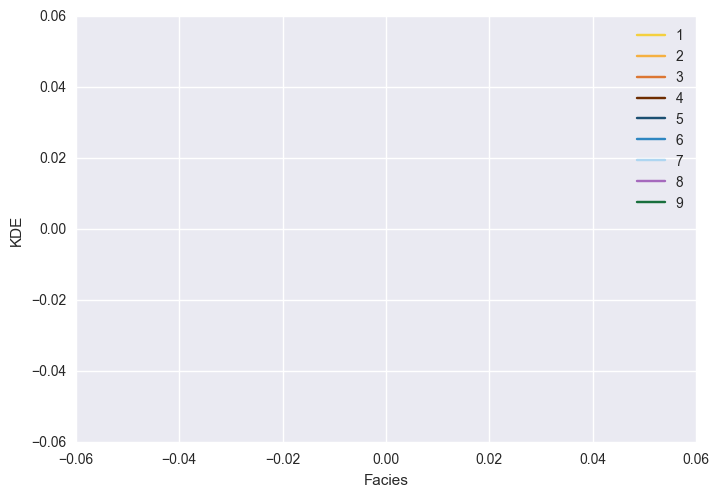

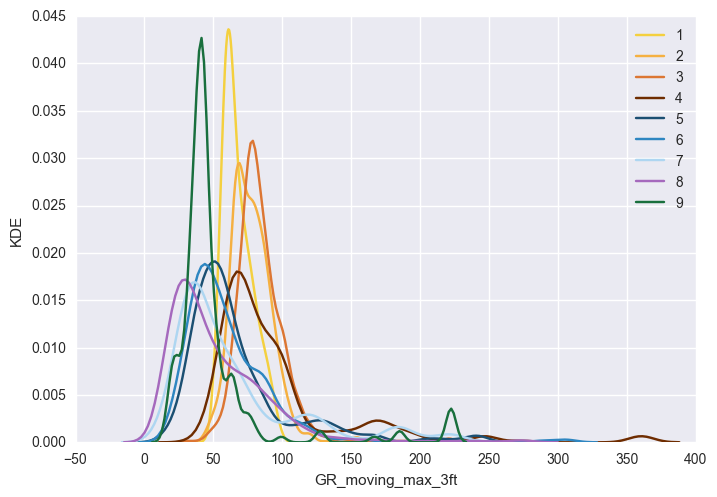

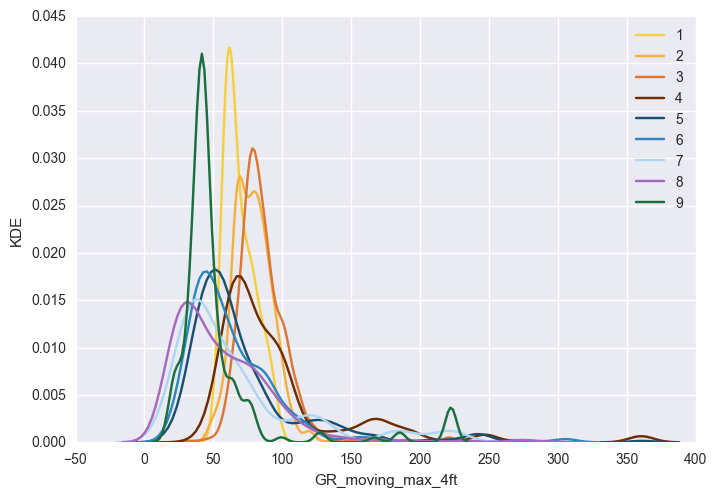

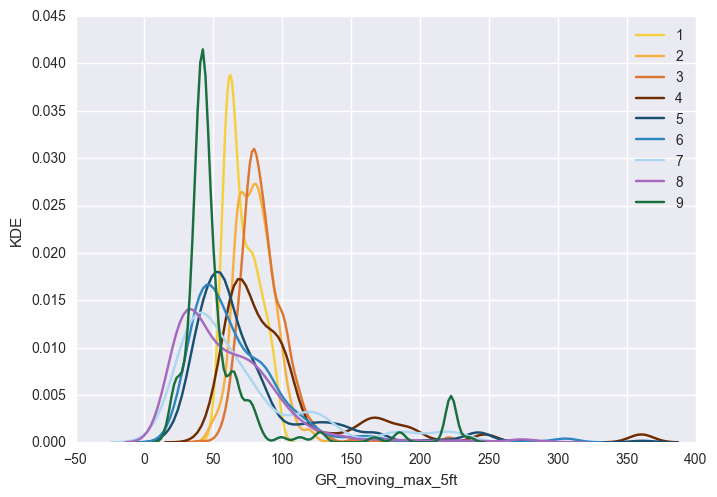

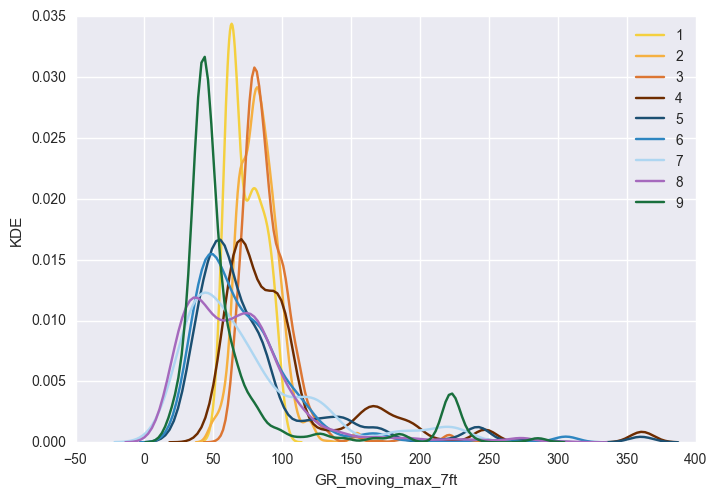

...

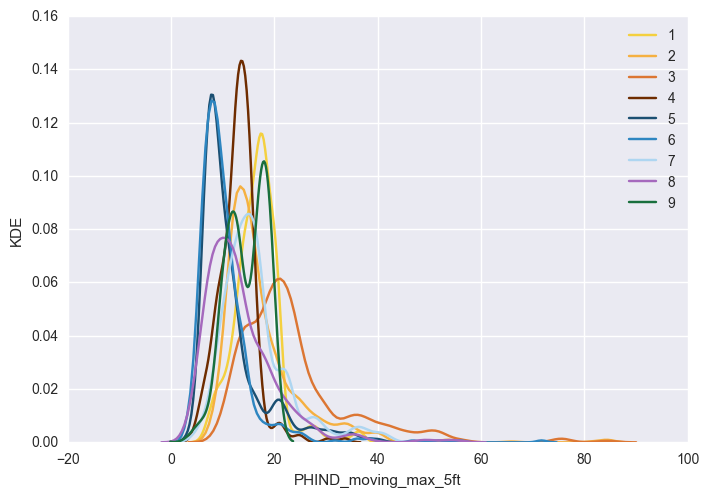

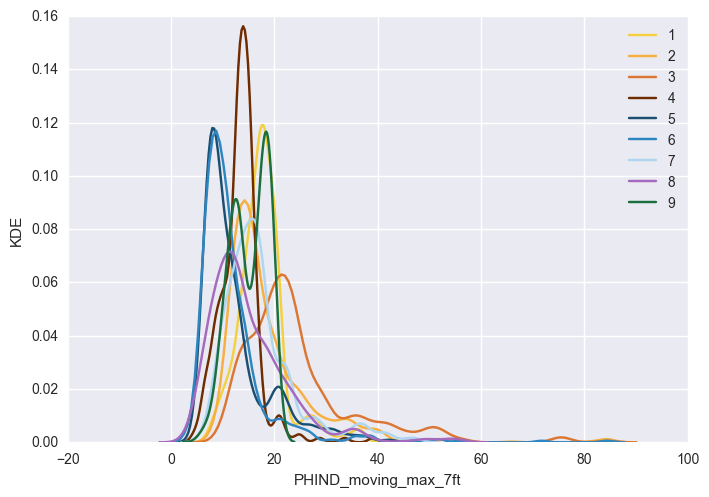

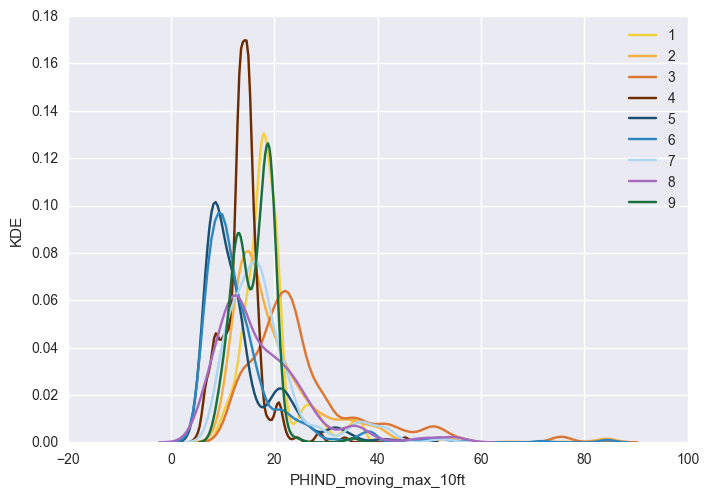

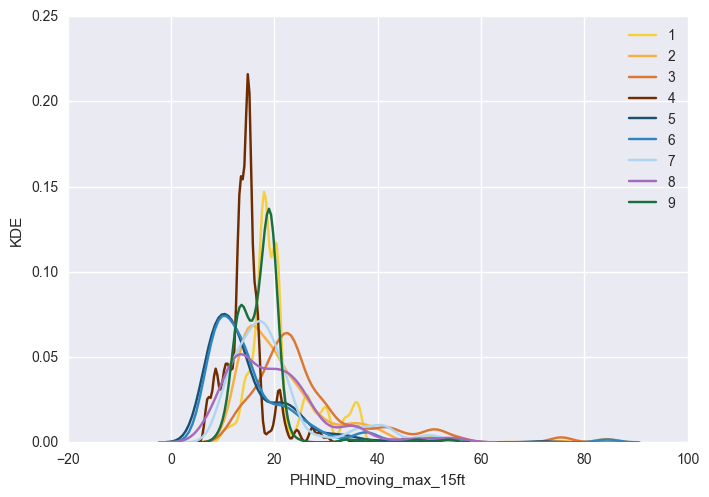

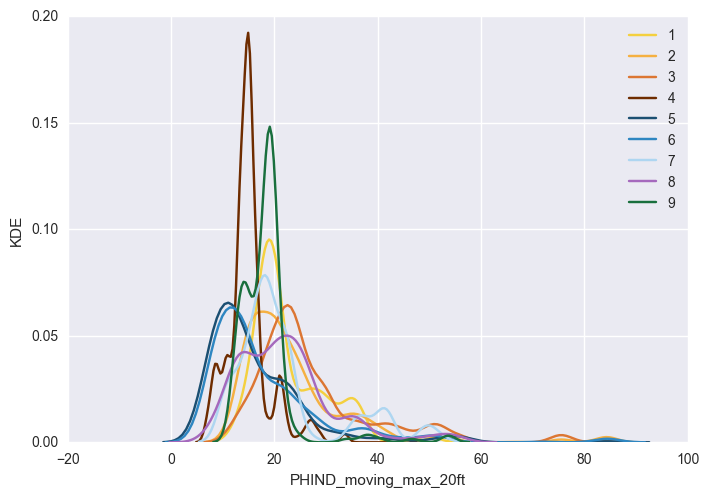

In [6]:
sns.set_palette(flatui)
list_variables = list(moving_max_df.columns.values)
list_variables.remove('Formation')
list_variables.remove('Well Name')
list_variables.remove('Depth')
#list_variables = ['GR_cD_step_level_1', 'GR_cA_step_level_1', 'GR_cD_step_level_2', 'GR_cA_step_level_2', 'GR_cD_step_level_3', 'GR_cA_step_level_3']
for a in list_variables:
    for i in np.arange(1, 10, 1):
        sns.kdeplot(moving_max_df[a][moving_max_df['Facies'] == i], label=i)
    plt.xlabel(a)
    plt.ylabel('KDE')
    plt.show()